# Question 1


In [ ]:
'''
python by:  youngjung uh, Clova ML, Naver
contact:    youngjung.uh@navercorp.com
date:       17 Dec 2018

-------------------------------------------------------------------
----- below comment came from the original (flowToColor.m) --------
-------------------------------------------------------------------
flowToColor(flow, maxFlow) flowToColor color codes flow field, normalize
based on specified value,

flowToColor(flow) flowToColor color codes flow field, normalize
based on maximum flow present otherwise

According to the c++ source code of Daniel Scharstein
Contact: schar@middlebury.edu

Author: Deqing Sun, Department of Computer Science, Brown University
Contact: dqsun@cs.brown.edu
$Date: 2007-10-31 18:33:30 (Wed, 31 Oct 2006) $

Copyright 2007, Deqing Sun.

                        All Rights Reserved

Permission to use, copy, modify, and distribute this software and its
documentation for any purpose other than its incorporation into a
commercial product is hereby granted without fee, provided that the
above copyright notice appear in all copies and that both that
copyright notice and this permission notice appear in supporting
documentation, and that the name of the author and Brown University not be used in
advertising or publicity pertaining to distribution of the software
without specific, written prior permission.

THE AUTHOR AND BROWN UNIVERSITY DISCLAIM ALL WARRANTIES WITH REGARD TO THIS SOFTWARE,
INCLUDING ALL IMPLIED WARRANTIES OF MERCHANTABILITY AND FITNESS FOR ANY
PARTICULAR PURPOSE.  IN NO EVENT SHALL THE AUTHOR OR BROWN UNIVERSITY BE LIABLE FOR
ANY SPECIAL, INDIRECT OR CONSEQUENTIAL DAMAGES OR ANY DAMAGES
WHATSOEVER RESULTING FROM LOSS OF USE, DATA OR PROFITS, WHETHER IN AN
ACTION OF CONTRACT, NEGLIGENCE OR OTHER TORTIOUS ACTION, ARISING OUT OF
OR IN CONNECTION WITH THE USE OR PERFORMANCE OF THIS SOFTWARE.
'''

import numpy as np

def flowToColor(flow, maxflow=None, verbose=False):
    '''
    args
        flow (numpy array) height x width x 2
    return
        img_color (numpy array) height x width x 3
    '''

    UNKNOWN_FLOW_THRESH = 5e2
    eps = 1e-6

    height, widht, nBands = flow.shape

    if nBands != 2:
        exit('flowToColor: image must have two bands')

    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999
    maxv = -999

    minu = 999
    minv = 999
    maxrad = -1

    # fix unknown flow
    idxUnknown = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknown] = 0
    v[idxUnknown] = 0

    maxu = max(maxu, u.max())
    minu = min(minu, u.min())

    maxv = max(maxv, v.max())
    minv = min(minv, v.min())

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(maxrad, rad.max())

    if verbose:
        print('max flow: %.4f flow range: u = %.3f .. %.3f; v = %.3f .. %.3f\n' %
              (maxrad, minu, maxu, minv, maxv))

    if maxflow is not None:
        if maxflow > 0:
            maxrad = maxflow

    u = u / (maxrad + eps)
    v = v / (maxrad + eps)

    img = computeColor(u, v)

    # unknown flow
    # IDX = repmat(idxUnknown, [1, 1, 3])
    img[idxUnknown] = 0

    return img

def computeColor(u, v, cast_uint8=True):
    '''
    args
        u (numpy array) height x width
        v (numpy array) height x width
        cast_uint8 (bool) set False to have image range 0-1 (np.float32)
    return
        img_color (numpy array) height x width x 3
    '''

    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = makeColorwheel()
    ncols = colorwheel.shape[0]

    rad = np.sqrt(u ** 2 + v ** 2)

    a = np.arctan2(-v, -u)/np.pi

    fk = (a + 1) / 2 * (ncols - 1)  # -1~1 maped to 1~ncols

    k0 = np.floor(fk).astype(int)  # 1, 2, ..., ncols

    k1 = k0 + 1
    k1[k1 == ncols + 1] = 1

    f = fk - k0

    height, width = u.shape
    img = np.zeros((height, width, 3), np.float32)
    nrows = colorwheel.shape[1]
    for i in range(nrows):
        tmp = colorwheel[:, i]
        col0 = tmp[k0.reshape(-1)] / 255
        col1 = tmp[k1.reshape(-1)] / 255
        col = col0.reshape(height, width) * (1 - f) + \
              col1.reshape(height, width) * f

        idx = rad <= 1
        col[idx] = 1 - rad[idx] * (1 - col[idx])  # increase saturation with radius

        col[np.logical_not(idx)] *= 0.75  # out of range

        img[:, :, i] = col * (1 - nanIdx)

    if cast_uint8:
        img = np.floor(img * 255).astype(np.uint8)
    return img


def makeColorwheel():
    '''
    color encoding scheme
    adapted from the color circle idea described at
    http://members.shaw.ca/quadibloc/other/colint.htm
    '''

    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros((ncols, 3))  # r g b

    col = 0
    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.floor(255*np.array(range(RY))/RY)
    col = col+RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.floor(255*np.array(range(YG))/YG)
    colorwheel[col:col+YG, 1] = 255
    col = col+YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.floor(255*np.array(range(GC))/GC)
    col = col+GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.floor(255*np.array(range(CB))/CB)
    colorwheel[col:col+CB, 2] = 255
    col = col+CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.floor(255*np.array(range(BM))/BM)
    col = col+BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.floor(255*np.array(range(MR))/MR)
    colorwheel[col:col+MR, 0] = 255

    return colorwheel


# flowToColor(np.zeros((224,224,2)))

In [ ]:
def myFlow(img1, img2, window_length, threshold):
    # Convert images to grayscale and normalize intensity
    img1_gray = img1.mean(axis=2) / 255.0
    img2_gray = img2.mean(axis=2) / 255.0

    # Compute spatial derivatives using central differences filter
    kernel = np.array([-1, 8, 0, -8, 1]) / 12.0
    Ix = convolve2d(img1_gray, kernel.reshape(1, -1), mode='same', boundary='symm')
    Iy = convolve2d(img1_gray, kernel.reshape(-1, 1), mode='same', boundary='symm')

    # Compute temporal derivative
    It = convolve2d(img2_gray, np.ones((3, 3))/9, mode='same', boundary='symm') - \
         convolve2d(img1_gray, np.ones((3, 3))/9, mode='same', boundary='symm')

    # Apply Gaussian filtering
    sigma = 1
    img1_smooth = convolve(img1_gray, np.ones((3, 3))/9, mode='constant', cval=0.0)
    img2_smooth = convolve(img2_gray, np.ones((3, 3))/9, mode='constant', cval=0.0)

    # Initialize flow components
    u = np.zeros_like(img1_gray)
    v = np.zeros_like(img1_gray)
    valid_flow = np.zeros_like(img1_gray, dtype=bool)

    # Compute optical flow for each pixel
    for i in range(window_length//2, img1_gray.shape[0] - window_length//2):
        for j in range(window_length//2, img1_gray.shape[1] - window_length//2):
            Ix_window = Ix[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]
            Iy_window = Iy[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]
            It_window = It[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]

            A = np.array([[np.sum(Ix_window**2), np.sum(Ix_window*Iy_window)],
                          [np.sum(Ix_window*Iy_window), np.sum(Iy_window**2)]])
            b = -np.array([np.sum(Ix_window*It_window), np.sum(Iy_window*It_window)])

            if np.linalg.cond(A) < 1/sys.float_info.epsilon:  # Check invertibility
                flow = np.linalg.solve(A, b)
                u[i, j] = flow[0]
                v[i, j] = flow[1]
                valid_flow[i, j] = True

    # Thresholding invalid flow
    invalid_indices = np.logical_or(np.isnan(u), np.isnan(v))
    u[invalid_indices] = 0
    v[invalid_indices] = 0


    return u, v, valid_flow

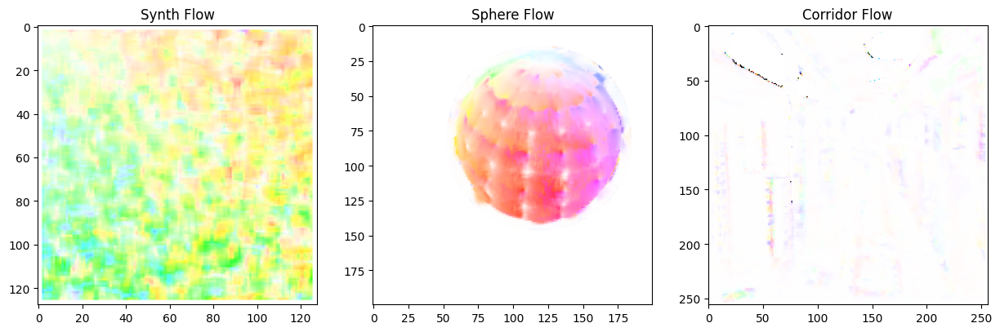

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import convolve
from scipy.signal import convolve2d
import sys


def main():
    # Load images
    img1_synth = cv2.imread('synth_0.png')
    img2_synth = cv2.imread('synth_1.png')
    img1_sphere = cv2.imread('sphere_0.png')
    img2_sphere = cv2.imread('sphere_1.png')
    img1_corridor = cv2.imread('bt_0.png')
    img2_corridor = cv2.imread('bt_1.png')

    # Initialize parameters
    window_length = 5
    threshold = 0.01

    # Compute optical flow for each image set
    u_synth, v_synth, valid_flow_synth = myFlow(img1_synth, img2_synth, window_length, threshold)
    flow_color_synth = flowToColor(np.stack((u_synth, v_synth), axis=-1))
    u_sphere, v_sphere, valid_flow_sphere = myFlow(img1_sphere, img2_sphere, window_length, threshold)
    flow_color_sphere = flowToColor(np.stack((u_sphere, v_sphere), axis=-1))
    u_corridor, v_corridor, valid_flow_corridor = myFlow(img1_corridor, img2_corridor, window_length, threshold)
    flow_color_corridor = flowToColor(np.stack((u_corridor, v_corridor), axis=-1))

    # Visualize flow fields
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(flow_color_synth)
    plt.title('Synth Flow')
    plt.subplot(1, 3, 2)
    plt.imshow(flow_color_sphere)
    plt.title('Sphere Flow')
    plt.subplot(1, 3, 3)
    plt.imshow(flow_color_corridor)
    plt.title('Corridor Flow')
    plt.show()

if __name__ == "__main__":
    main()


# Question 2


In [ ]:
'''
python by:  youngjung uh, Clova ML, Naver
contact:    youngjung.uh@navercorp.com
date:       17 Dec 2018

-------------------------------------------------------------------
----- below comment came from the original (flowToColor.m) --------
-------------------------------------------------------------------
flowToColor(flow, maxFlow) flowToColor color codes flow field, normalize
based on specified value,

flowToColor(flow) flowToColor color codes flow field, normalize
based on maximum flow present otherwise

According to the c++ source code of Daniel Scharstein
Contact: schar@middlebury.edu

Author: Deqing Sun, Department of Computer Science, Brown University
Contact: dqsun@cs.brown.edu
$Date: 2007-10-31 18:33:30 (Wed, 31 Oct 2006) $

Copyright 2007, Deqing Sun.

                        All Rights Reserved

Permission to use, copy, modify, and distribute this software and its
documentation for any purpose other than its incorporation into a
commercial product is hereby granted without fee, provided that the
above copyright notice appear in all copies and that both that
copyright notice and this permission notice appear in supporting
documentation, and that the name of the author and Brown University not be used in
advertising or publicity pertaining to distribution of the software
without specific, written prior permission.

THE AUTHOR AND BROWN UNIVERSITY DISCLAIM ALL WARRANTIES WITH REGARD TO THIS SOFTWARE,
INCLUDING ALL IMPLIED WARRANTIES OF MERCHANTABILITY AND FITNESS FOR ANY
PARTICULAR PURPOSE.  IN NO EVENT SHALL THE AUTHOR OR BROWN UNIVERSITY BE LIABLE FOR
ANY SPECIAL, INDIRECT OR CONSEQUENTIAL DAMAGES OR ANY DAMAGES
WHATSOEVER RESULTING FROM LOSS OF USE, DATA OR PROFITS, WHETHER IN AN
ACTION OF CONTRACT, NEGLIGENCE OR OTHER TORTIOUS ACTION, ARISING OUT OF
OR IN CONNECTION WITH THE USE OR PERFORMANCE OF THIS SOFTWARE.
'''

import numpy as np

def flowToColor(flow, maxflow=None, verbose=False):
    '''
    args
        flow (numpy array) height x width x 2
    return
        img_color (numpy array) height x width x 3
    '''

    UNKNOWN_FLOW_THRESH = 5e2
    eps = 1e-6

    height, widht, nBands = flow.shape

    if nBands != 2:
        exit('flowToColor: image must have two bands')

    u = flow[:, :, 0]
    v = flow[:, :, 1]

    maxu = -999
    maxv = -999

    minu = 999
    minv = 999
    maxrad = -1

    # fix unknown flow
    idxUnknown = (abs(u) > UNKNOWN_FLOW_THRESH) | (abs(v) > UNKNOWN_FLOW_THRESH)
    u[idxUnknown] = 0
    v[idxUnknown] = 0

    maxu = max(maxu, u.max())
    minu = min(minu, u.min())

    maxv = max(maxv, v.max())
    minv = min(minv, v.min())

    rad = np.sqrt(u ** 2 + v ** 2)
    maxrad = max(maxrad, rad.max())

    if verbose:
        print('max flow: %.4f flow range: u = %.3f .. %.3f; v = %.3f .. %.3f\n' %
              (maxrad, minu, maxu, minv, maxv))

    if maxflow is not None:
        if maxflow > 0:
            maxrad = maxflow

    u = u / (maxrad + eps)
    v = v / (maxrad + eps)

    img = computeColor(u, v)

    # unknown flow
    # IDX = repmat(idxUnknown, [1, 1, 3])
    img[idxUnknown] = 0

    return img

def computeColor(u, v, cast_uint8=True):
    '''
    args
        u (numpy array) height x width
        v (numpy array) height x width
        cast_uint8 (bool) set False to have image range 0-1 (np.float32)
    return
        img_color (numpy array) height x width x 3
    '''

    nanIdx = np.isnan(u) | np.isnan(v)
    u[nanIdx] = 0
    v[nanIdx] = 0

    colorwheel = makeColorwheel()
    ncols = colorwheel.shape[0]

    rad = np.sqrt(u ** 2 + v ** 2)

    a = np.arctan2(-v, -u)/np.pi

    fk = (a + 1) / 2 * (ncols - 1)  # -1~1 maped to 1~ncols

    k0 = np.floor(fk).astype(int)  # 1, 2, ..., ncols

    k1 = k0 + 1
    k1[k1 == ncols + 1] = 1

    f = fk - k0

    height, width = u.shape
    img = np.zeros((height, width, 3), np.float32)
    nrows = colorwheel.shape[1]
    for i in range(nrows):
        tmp = colorwheel[:, i]
        col0 = tmp[k0.reshape(-1)] / 255
        col1 = tmp[k1.reshape(-1)] / 255
        col = col0.reshape(height, width) * (1 - f) + \
              col1.reshape(height, width) * f

        idx = rad <= 1
        col[idx] = 1 - rad[idx] * (1 - col[idx])  # increase saturation with radius

        col[np.logical_not(idx)] *= 0.75  # out of range

        img[:, :, i] = col * (1 - nanIdx)

    if cast_uint8:
        img = np.floor(img * 255).astype(np.uint8)
    return img


def makeColorwheel():
    '''
    color encoding scheme
    adapted from the color circle idea described at
    http://members.shaw.ca/quadibloc/other/colint.htm
    '''

    RY = 15
    YG = 6
    GC = 4
    CB = 11
    BM = 13
    MR = 6

    ncols = RY + YG + GC + CB + BM + MR

    colorwheel = np.zeros((ncols, 3))  # r g b

    col = 0
    # RY
    colorwheel[0:RY, 0] = 255
    colorwheel[0:RY, 1] = np.floor(255*np.array(range(RY))/RY)
    col = col+RY

    # YG
    colorwheel[col:col+YG, 0] = 255 - np.floor(255*np.array(range(YG))/YG)
    colorwheel[col:col+YG, 1] = 255
    col = col+YG

    # GC
    colorwheel[col:col+GC, 1] = 255
    colorwheel[col:col+GC, 2] = np.floor(255*np.array(range(GC))/GC)
    col = col+GC

    # CB
    colorwheel[col:col+CB, 1] = 255 - np.floor(255*np.array(range(CB))/CB)
    colorwheel[col:col+CB, 2] = 255
    col = col+CB

    # BM
    colorwheel[col:col+BM, 2] = 255
    colorwheel[col:col+BM, 0] = np.floor(255*np.array(range(BM))/BM)
    col = col+BM

    # MR
    colorwheel[col:col+MR, 2] = 255 - np.floor(255*np.array(range(MR))/MR)
    colorwheel[col:col+MR, 0] = 255

    return colorwheel


# flowToColor(np.zeros((224,224,2)))

In [ ]:
import numpy as np
from scipy.ndimage import convolve
from scipy.signal import convolve2d
import sys

def myFlow(img1, img2, window_length, threshold):
    # Convert images to grayscale and normalize intensity
    img1_gray = img1.mean(axis=2) / 255.0
    img2_gray = img2.mean(axis=2) / 255.0

    # Compute spatial derivatives using central differences filter
    kernel = np.array([-1, 8, 0, -8, 1]) / 12.0
    Ix = convolve2d(img1_gray, kernel.reshape(1, -1), mode='same', boundary='symm')
    Iy = convolve2d(img1_gray, kernel.reshape(-1, 1), mode='same', boundary='symm')

    # Compute temporal derivative
    It = convolve2d(img2_gray, np.ones((3, 3))/9, mode='same', boundary='symm') - \
         convolve2d(img1_gray, np.ones((3, 3))/9, mode='same', boundary='symm')

    # Apply Gaussian filtering
    sigma = 1
    img1_smooth = convolve(img1_gray, np.ones((3, 3))/9, mode='constant', cval=0.0)
    img2_smooth = convolve(img2_gray, np.ones((3, 3))/9, mode='constant', cval=0.0)

    # Initialize flow components
    u = np.zeros_like(img1_gray)
    v = np.zeros_like(img1_gray)
    valid_flow = np.zeros_like(img1_gray, dtype=bool)

    # Compute optical flow for each pixel
    for i in range(window_length//2, img1_gray.shape[0] - window_length//2):
        for j in range(window_length//2, img1_gray.shape[1] - window_length//2):
            Ix_window = Ix[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]
            Iy_window = Iy[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]
            It_window = It[i-window_length//2:i+window_length//2+1, j-window_length//2:j+window_length//2+1]

            A = np.array([[np.sum(Ix_window**2), np.sum(Ix_window*Iy_window)],
                          [np.sum(Ix_window*Iy_window), np.sum(Iy_window**2)]])
            b = -np.array([np.sum(Ix_window*It_window), np.sum(Iy_window*It_window)])

            if np.linalg.cond(A) < 1/sys.float_info.epsilon:  # Check invertibility
                flow = np.linalg.solve(A, b)
                u[i, j] = flow[0]
                v[i, j] = flow[1]
                valid_flow[i, j] = True

    # Thresholding invalid flow
    invalid_indices = np.logical_or(np.isnan(u), np.isnan(v))
    u[invalid_indices] = 0
    v[invalid_indices] = 0


    return u, v, valid_flow

In [ ]:
def myWarp(img, u, v):
    height, width = img.shape[:2]
    x, y = np.meshgrid(np.arange(width), np.arange(height))
    x_warped = np.clip(x + u, 0, width - 1)
    y_warped = np.clip(y + v, 0, height - 1)
    warped_img = cv2.remap(img, x_warped.astype(np.float32), y_warped.astype(np.float32), cv2.INTER_LINEAR)
    return warped_img

In [ ]:
import cv2
import numpy as np
from scipy.interpolate import interp2d
import matplotlib.pyplot as plt

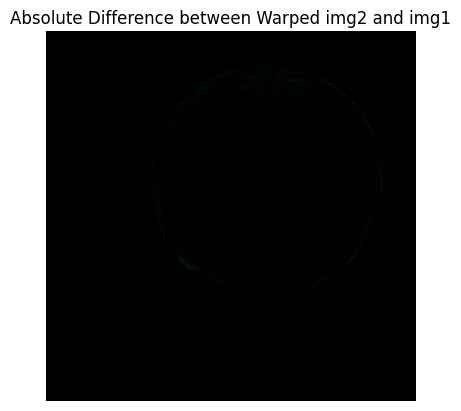

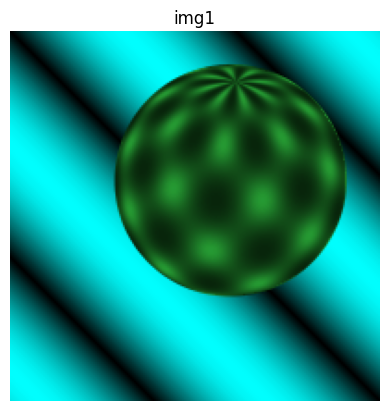

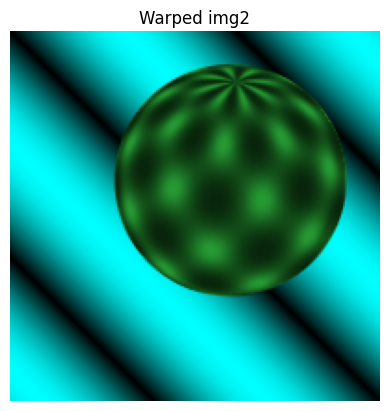

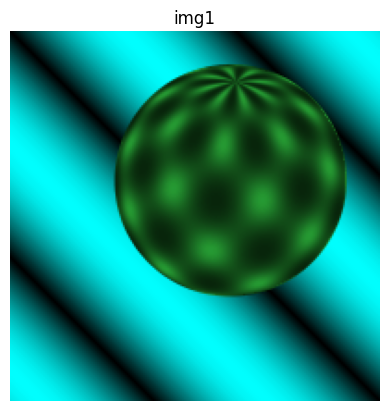

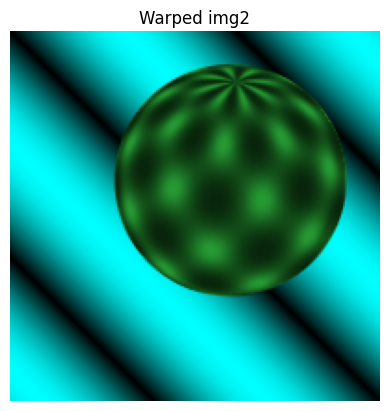

...

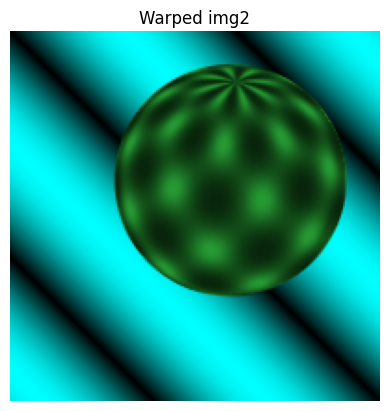

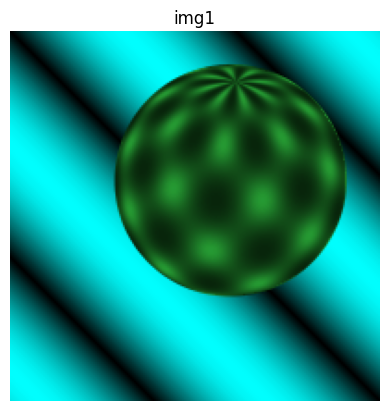

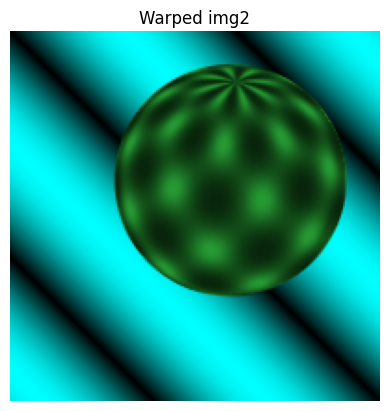

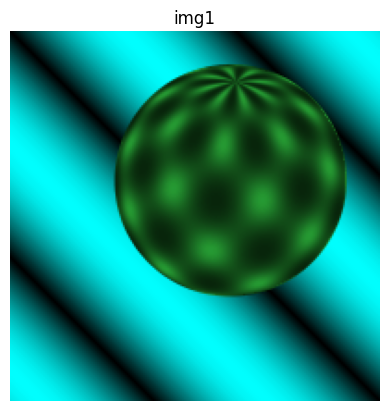

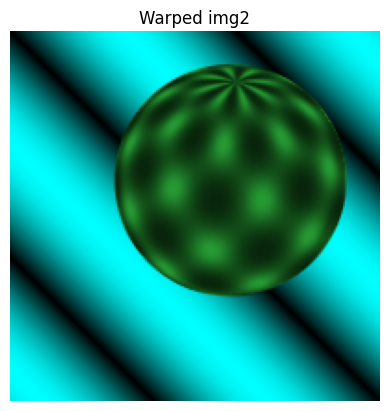

In [ ]:
img1 = cv2.imread('sphere_0.png')
img2 = cv2.imread('sphere_1.png')

# Compute optical flow
u, v, _ = myFlow(img1, img2, window_length=5, threshold=0.01)

# Warp img2 with the computed flow
warped_img2 = myWarp(img2, u, v)

# Visualize the difference between the warped img2 and img1
diff_img = np.abs(warped_img2.astype(int) - img1.astype(int))
plt.imshow(diff_img)
plt.title('Absolute Difference between Warped img2 and img1')
plt.axis('off')
plt.show()

num_iterations = 5
for i in range(num_iterations):
    plt.imshow(img1)
    plt.title('img1')
    plt.axis('off')
    plt.show()
    plt.imshow(warped_img2)
    plt.title('Warped img2')
    plt.axis('off')
    plt.show()

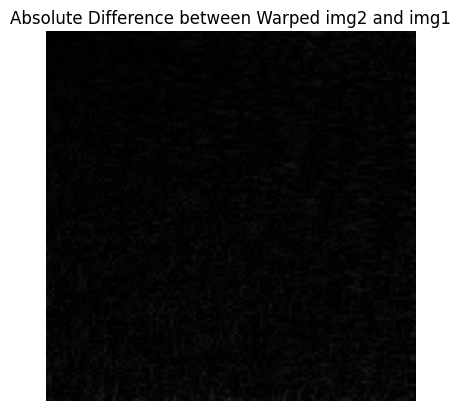

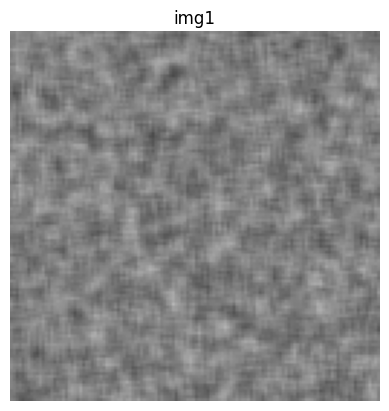

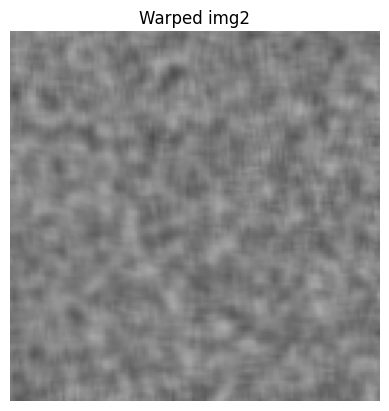

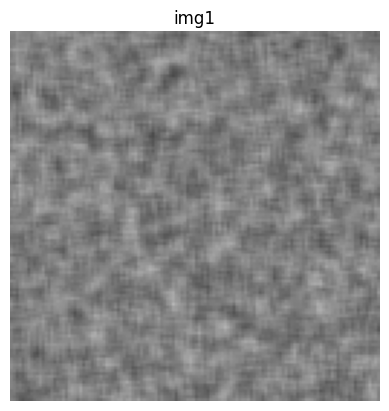

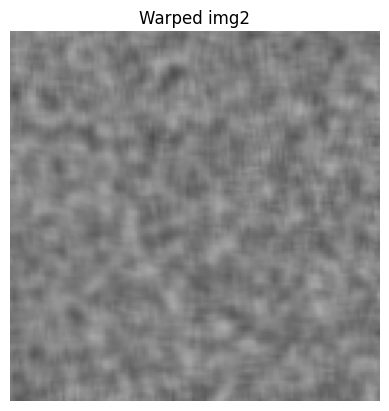

...

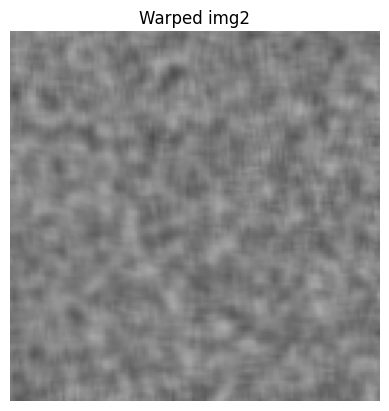

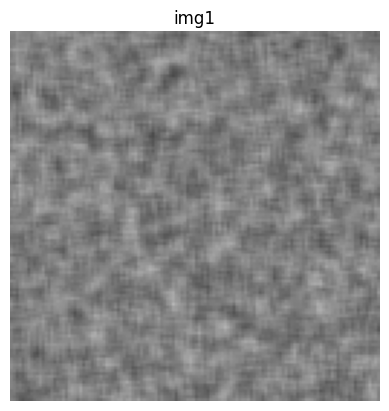

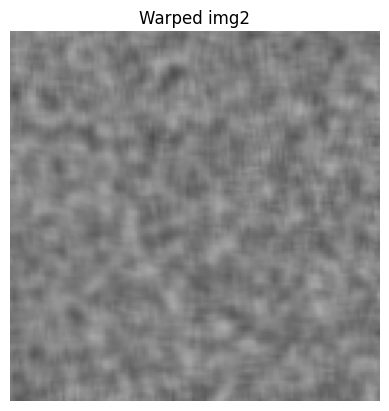

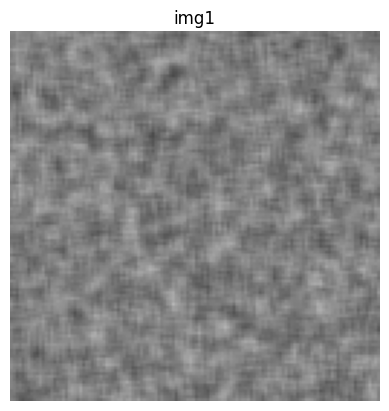

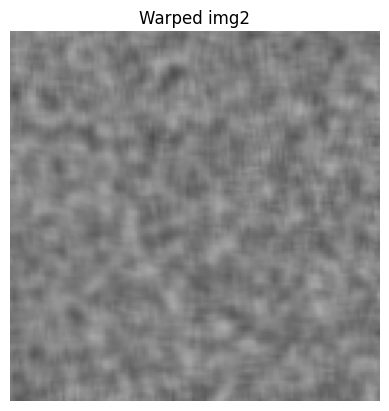

In [ ]:
img1 = cv2.imread('synth_0.png')
img2 = cv2.imread('synth_1.png')

# Compute optical flow
u, v, _ = myFlow(img1, img2, window_length=5, threshold=0.01)

# Warp img2 with the computed flow
warped_img2 = myWarp(img2, u, v)

# Visualize the difference between the warped img2 and img1
diff_img = np.abs(warped_img2.astype(int) - img1.astype(int))
plt.imshow(diff_img)
plt.title('Absolute Difference between Warped img2 and img1')
plt.axis('off')
plt.show()

num_iterations = 5
for i in range(num_iterations):
    plt.imshow(img1)
    plt.title('img1')
    plt.axis('off')
    plt.show()
    plt.imshow(warped_img2)
    plt.title('Warped img2')
    plt.axis('off')
    plt.show()

# Question 3

In [ ]:
import cv2
import numpy as np
import random
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from skimage import io, feature

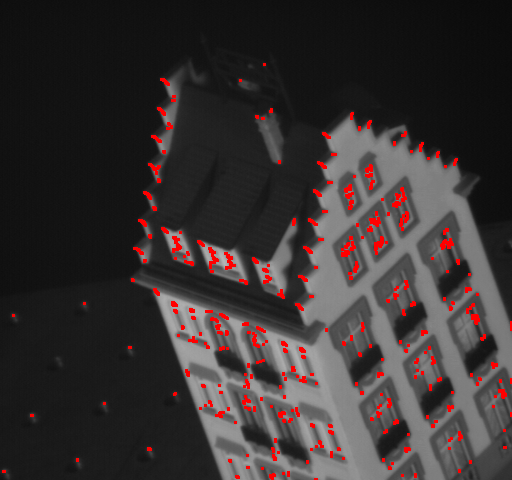

In [ ]:
# Part 1: Detect a set of keypoints in the initial frame using the Harris Corner detector

# Load the initial frame
initial_frame_path = "hotel.seq0.png"  # Update with actual path
initial_frame = cv2.imread(initial_frame_path)

# Convert the input image into grayscale color space
initial_gray = cv2.cvtColor(initial_frame, cv2.COLOR_BGR2GRAY)

# Modify the data type to 32-bit floating point
operated_image = np.float32(initial_gray)

# Apply the cv2.cornerHarris method to detect the corners with appropriate values as input parameters
dest = cv2.cornerHarris(operated_image, 2, 5, 0.07)

# Mark the detected corners
dest = cv2.dilate(dest, None)
initial_frame[dest > 0.01 * dest.max()] = [0, 0, 255]

# Display the image with corners
cv2_imshow(initial_frame)

# Wait for user input to close the window
cv2.waitKey(0)
cv2.destroyAllWindows()

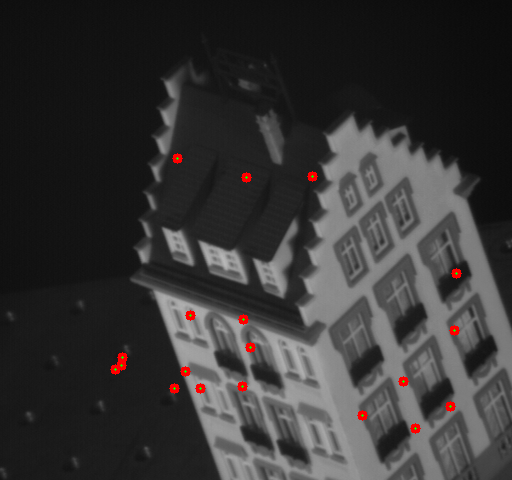

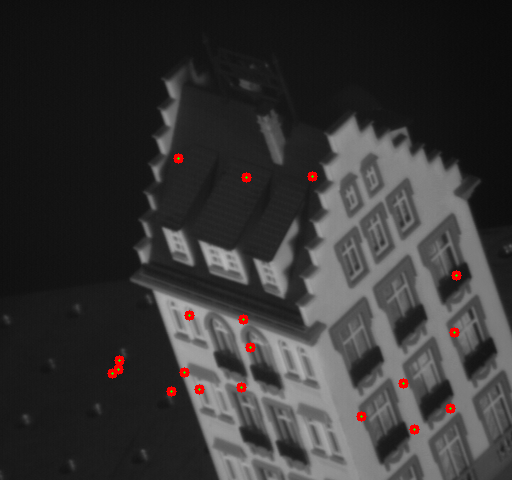

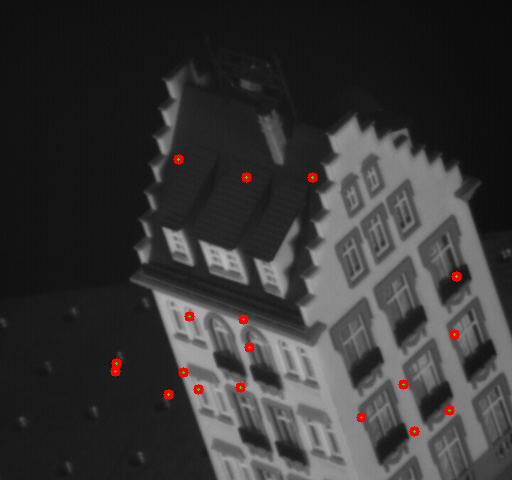

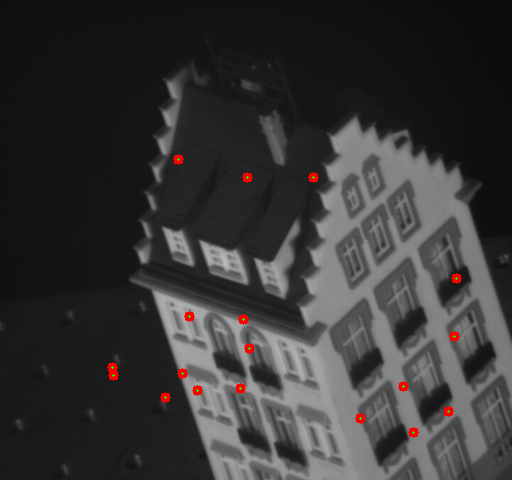

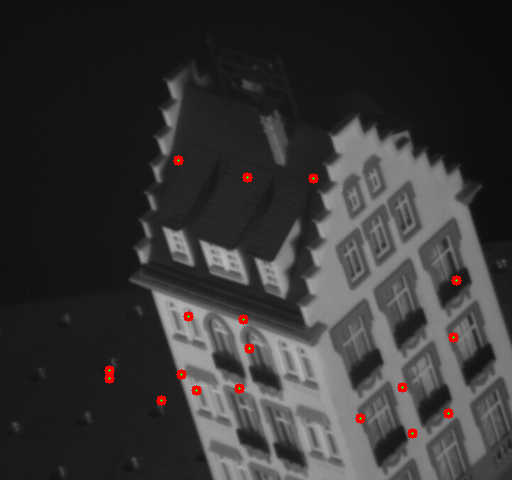

...

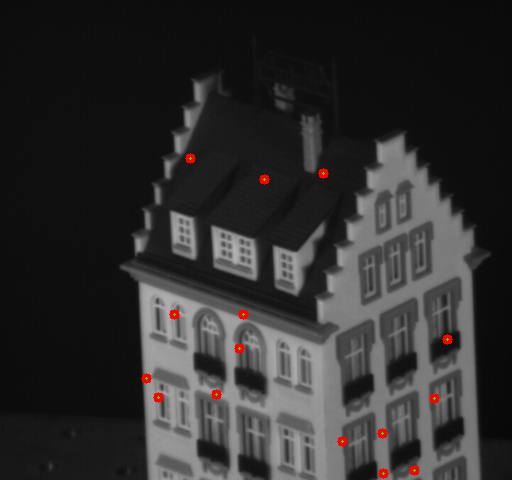

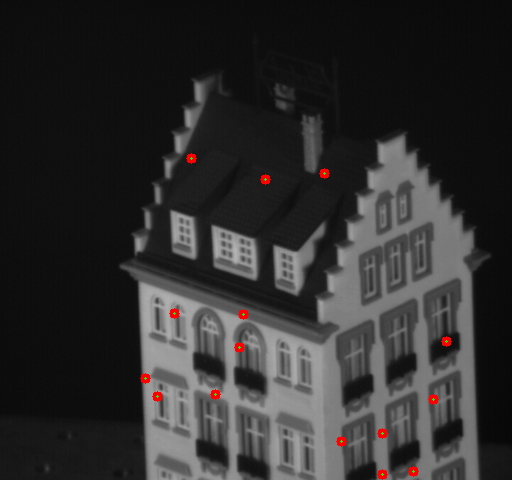

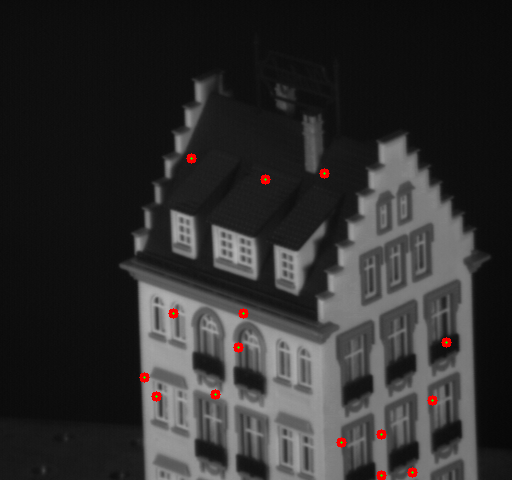

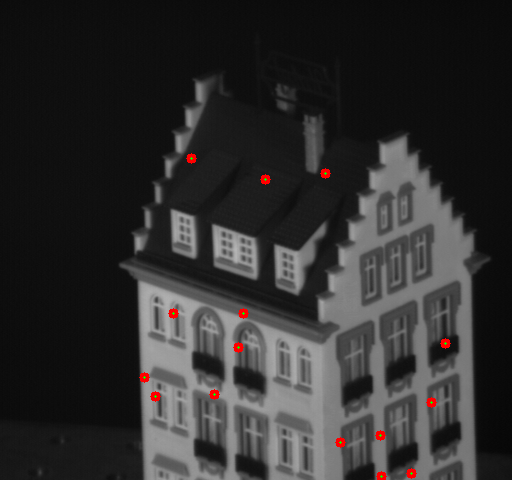

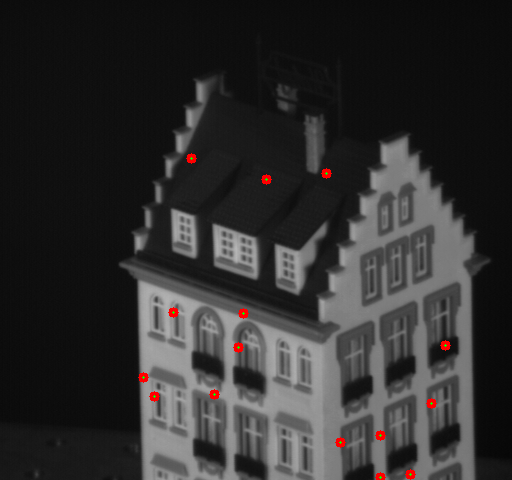

In [ ]:
# Part 2: Select 20 random keypoints in the initial frame and track them from one frame to the next using optical flow

# Get the coordinates of detected keypoints
keypoints_thresh = np.argwhere(dest > 0.01 * dest.max())

# Randomly select 20 keypoints
random.seed(42)  # For reproducibility
selected_indices = random.sample(range(len(keypoints_thresh)), 20)
selected_keypoints = [tuple(keypoints_thresh[i]) for i in selected_indices]

# Convert the initial frame to grayscale for tracking
prev_frame_gray = cv2.cvtColor(initial_frame, cv2.COLOR_BGR2GRAY)

# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15),
                 maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

# Convert selected keypoints to numpy array
prev_pts = np.array(selected_keypoints, dtype=np.float32).reshape(-1, 1, 2)

# Iterate through the sequence of frames
for i in range(1, 51):  # Assuming there are 50 frames in the sequence
    # Load the next frame
    next_frame_path = f"hotel.seq{i}.png"  # Update with actual path
    next_frame = cv2.imread(next_frame_path)
    next_frame_gray = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)

    # Calculate optical flow using Lucas-Kanade method
    next_pts, status, _ = cv2.calcOpticalFlowPyrLK(prev_frame_gray, next_frame_gray, prev_pts, None, **lk_params)

    # Filter out valid points and update selected keypoints
    good_new = next_pts[status == 1]
    selected_keypoints = [tuple(pt.ravel()) for pt in good_new]

    # Update for next iteration
    prev_frame_gray = next_frame_gray
    prev_pts = good_new.reshape(-1, 1, 2)

    # Draw keypoints and optical flow
    for i, (new, old) in enumerate(zip(good_new, prev_pts)):
        a, b = new.ravel()
        c, d = old.ravel()
        #print(a,b,c,d)
        a = int(a)
        b = int(b)
        c = int(c)
        d = int(d)
        next_frame = cv2.circle(next_frame, (a, b), 5, (0, 0, 255), -1)
        next_frame = cv2.line(next_frame, (a, b), (c, d), (0, 255, 0), 2)

    # Display the frame with keypoints and optical flow
    cv2_imshow(next_frame)
    if cv2.waitKey(30) & 0xff == 27:
        break

cv2.destroyAllWindows()

In [ ]:
# Part 3: Discard any keypoints if their predicted location moves out of the frame or is near the image borders

# List to store keypoints that move out of the frame or are near the borders
filtered_keypoints = []

# Iterate through the keypoints and filter out those that move out of the frame or are near the borders
for pt in selected_keypoints:
    x, y = pt
    if x < 5 or x > initial_gray.shape[1] - 5 or y < 5 or y > initial_gray.shape[0] - 5:
        continue  # Skip keypoints near the image borders
    filtered_keypoints.append(pt)

# Display the number of keypoints before and after filtering
print("Number of keypoints before filtering:", len(selected_keypoints))
print("Number of keypoints after filtering:", len(filtered_keypoints))

Number of keypoints before filtering: 15
Number of keypoints after filtering: 14


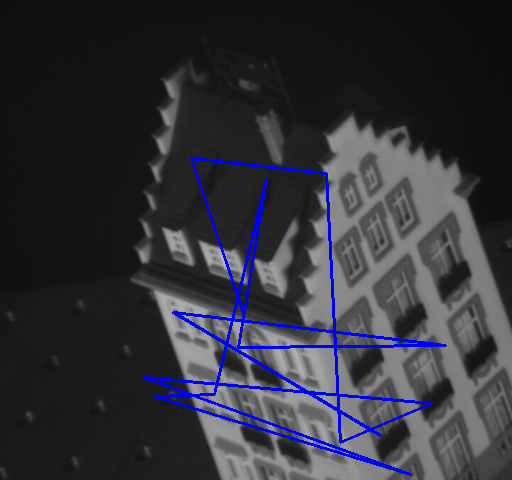

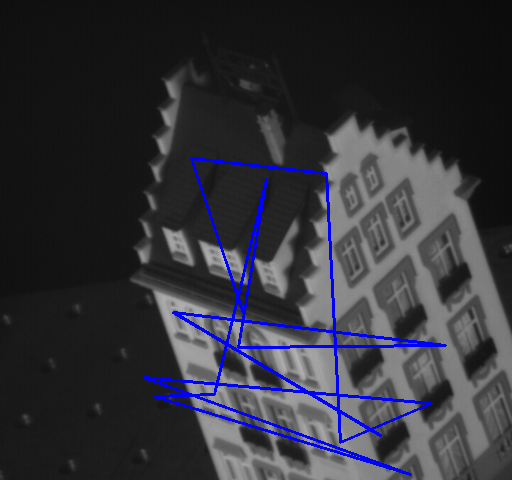

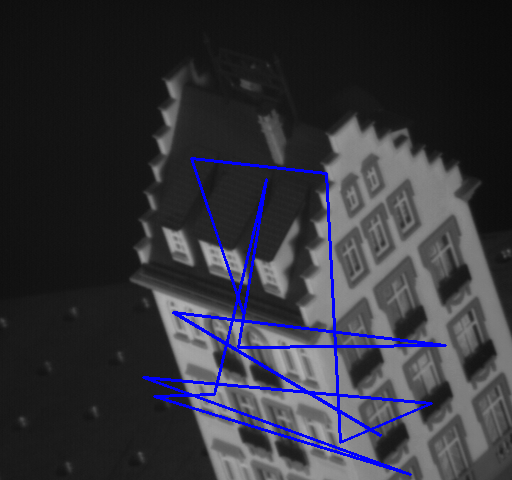

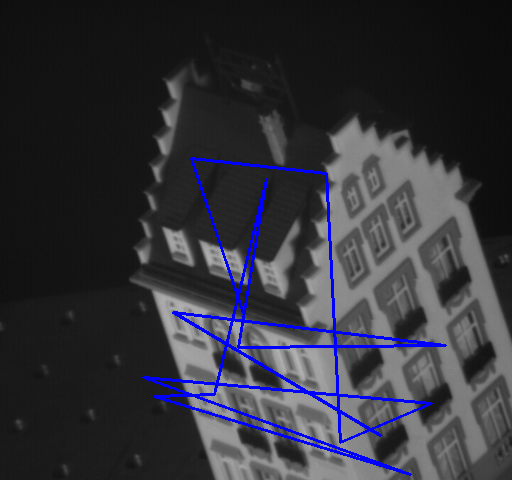

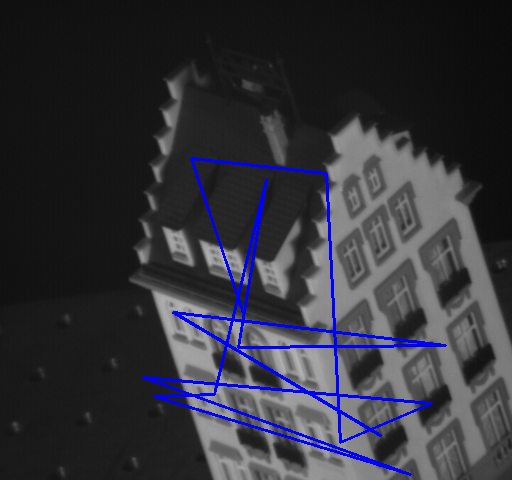

...

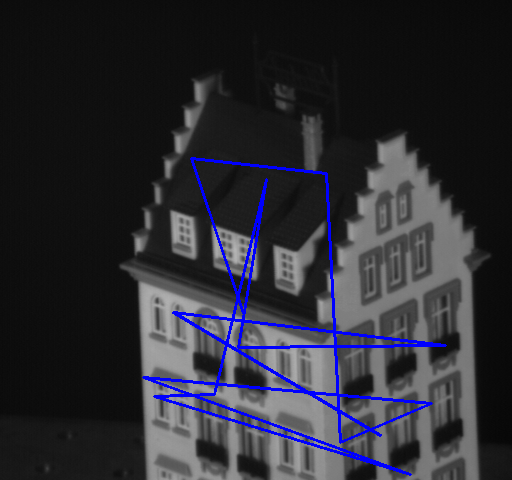

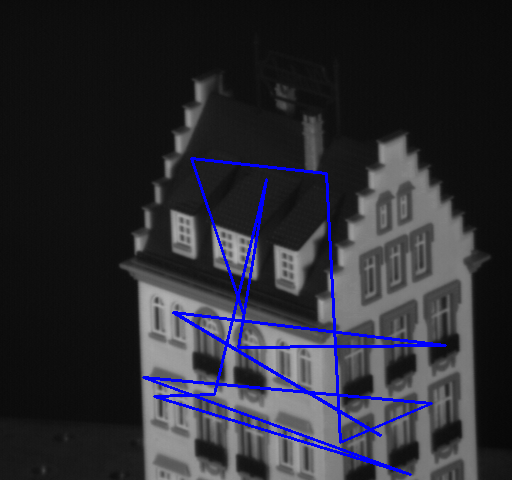

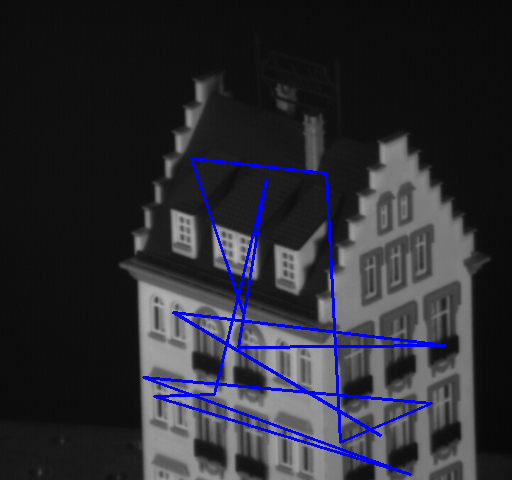

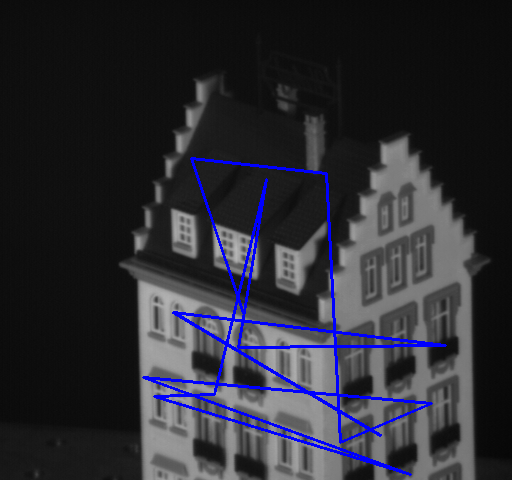

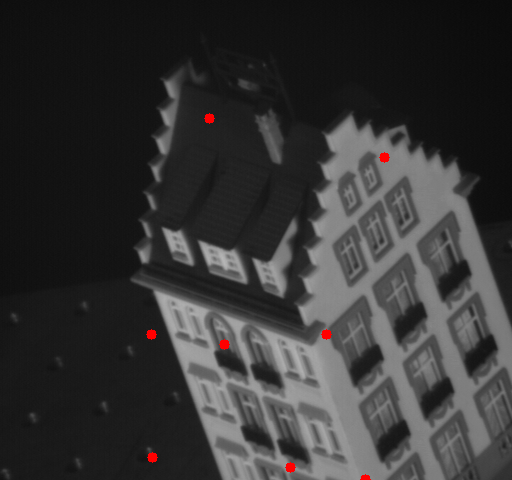

Number of keypoints out of frame: 8


In [ ]:
# Part 4: Displaying Image Sequence with Keypoint Paths

# We can directly use the frames from the loop in Part 2

# Iterate through the sequence of frames
for i in range(1, 51):  # Assuming there are 50 frames in the sequence
  next_frame_path = f"hotel.seq{i}.png"  # Update with actual path
  next_frame = cv2.imread(next_frame_path)
  next_frame_gray = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)

  # ... existing code for optical flow calculation ...

  # Draw lines connecting keypoint positions across frames
  for i in range(len(filtered_keypoints) - 1):
    prev_pt = tuple(map(int, filtered_keypoints[i]))  # Convert to integer coordinates
    curr_pt = tuple(map(int, filtered_keypoints[i + 1]))
    next_frame = cv2.line(next_frame, prev_pt, curr_pt, (255, 0, 0), 2)

  # Display the frame with keypoints and optical flow paths
  cv2_imshow(next_frame)
  if cv2.waitKey(30) & 0xff == 27:
    break

cv2.destroyAllWindows()

# Part 5: Displaying Out-of-Frame Keypoints

# This section will create a separate image, mark the filtered keypoints on
# the initial frame (Part 1), and display it

out_of_frame_pts = [pt for pt in selected_keypoints if pt not in filtered_keypoints]

# Copy the initial frame for visualization
out_of_frame_image = initial_frame.copy()

# Draw red circles on the initial frame for out-of-frame keypoints
for pt in out_of_frame_pts:
  pt_int = tuple(map(int, pt))  # Convert coordinates to integers
  out_of_frame_image = cv2.circle(out_of_frame_image, pt_int, 5, (0, 0, 255), -1)

# Display the initial frame with marked out-of-frame keypoints
cv2_imshow(out_of_frame_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

print("Number of keypoints out of frame:", len(out_of_frame_pts))
